In [1]:
# Import the libraries
import pandas as pd
import pandas_profiling
import numpy as np
import os
import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set()

In [2]:
# List the files in the folder
os.chdir('data')

In [3]:
# Import the two csv files
df1 = pd.read_csv('fire_archive_M6_96619.csv')
df2 = pd.read_csv('fire_nrt_M6_96619.csv')

# Overview of the dataframes

### About the first dataset :
MODIS standard quality Thermal Anomalies / Fire locations processed by the University of Maryland with a 3-month lag and distributed by FIRMS. These standard data (MCD14ML) replace the NRT (MCD14DL) files when available.

**latitude**: Center of 1km fire pixel but not necessarily the actual location of the fire as one or more fires can be detected within the 1km pixel.

**longitude**: Center of 1km fire pixel but not necessarily the actual location of the fire as one or more fires can be detected within the 1km pixel.

**brightness** Brightness temperature 21 (Kelvin): Channel 21/22 brightness temperature of the fire pixel measured in Kelvin.

**scan** Along Scan pixel size: The algorithm produces 1km fire pixels but MODIS pixels get bigger toward the edge of scan. Scan and track reflect actual pixel size.

**track** Along Track pixel size: The algorithm produces 1km fire pixels but MODIS pixels get bigger toward the edge of scan. Scan and track reflect actual pixel size.

**acq_date** Acquisition Date: Date of MODIS acquisition.

**acq_time** Acquisition Time: Time of acquisition/overpass of the satellite (in UTC).

**satellite** Satellite: A = Aqua and T = Terra.

**instrument** Instrument: Constant value for MODIS.

**confidence** Confidence (0-100%): This value is based on a collection of intermediate algorithm quantities used in the detection process. 

**version** Version (Collection and source): Version identifies the collection (e.g. MODIS Collection 6) and source of data processing: Near Real-Time (NRT suffix added to collection) or Standard Processing (collection only). "6.0NRT" - Collection 6 NRT processing. "6.0" - Collection 6 Standard processing. Find out more on collections and on the differences between FIRMS data sourced from LANCE FIRMS and University of Maryland.

**bright_t31** Brightness temperature 31 (Kelvin): Channel 31 brightness temperature of the fire pixel measured in Kelvin.

**frp** Fire Radiative Power: Depicts the pixel-integrated fire radiative power in MW (megawatts).

**daynight** Day / Night: D = Daytime, N = Nighttime

In [4]:
# Look at the first five rows
df1.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight,type
0,-11.8070,142.0583,313.0,1.0,1.0,2019-08-01,56,Terra,MODIS,48,6.3,297.3,6.6,D,0
1,-11.7924,142.0850,319.3,1.0,1.0,2019-08-01,56,Terra,MODIS,71,6.3,297.3,11.3,D,0
2,-12.8398,132.8744,311.6,3.1,1.7,2019-08-01,57,Terra,MODIS,42,6.3,298.7,23.1,D,0
3,-14.4306,143.3035,310.1,1.1,1.1,2019-08-01,57,Terra,MODIS,33,6.3,296.1,6.5,D,0
4,-12.4953,131.4897,310.3,4.0,1.9,2019-08-01,57,Terra,MODIS,36,6.3,298.8,27.6,D,0


In [5]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36011 entries, 0 to 36010
Data columns (total 15 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   latitude    36011 non-null  float64
 1   longitude   36011 non-null  float64
 2   brightness  36011 non-null  float64
 3   scan        36011 non-null  float64
 4   track       36011 non-null  float64
 5   acq_date    36011 non-null  object 
 6   acq_time    36011 non-null  int64  
 7   satellite   36011 non-null  object 
 8   instrument  36011 non-null  object 
 9   confidence  36011 non-null  int64  
 10  version     36011 non-null  float64
 11  bright_t31  36011 non-null  float64
 12  frp         36011 non-null  float64
 13  daynight    36011 non-null  object 
 14  type        36011 non-null  int64  
dtypes: float64(8), int64(3), object(4)
memory usage: 4.1+ MB


In [6]:
# Look at the shape of the DataFrame
df1.shape

(36011, 15)

In [7]:
# Percentage of the missing values in the DataFrame
round(df1.isna().sum()/df1.shape[0]*100, 2)

latitude      0.0
longitude     0.0
brightness    0.0
scan          0.0
track         0.0
acq_date      0.0
acq_time      0.0
satellite     0.0
instrument    0.0
confidence    0.0
version       0.0
bright_t31    0.0
frp           0.0
daynight      0.0
type          0.0
dtype: float64

### About the second dataset :

MODIS NRT files:(MCD14DL) MODIS Active Fire and Thermal Anomalies product processed by LANCE / FIRMS

This is the same as `df1`, because the datas come from the same instrument.

In [8]:
df2.head()

,latitude,longitude,brightness,scan,track,acq_date,acq_time,satellite,instrument,confidence,version,bright_t31,frp,daynight
0,-14.281,143.636,323.9,1.7,1.3,2019-10-01,25,Terra,MODIS,70,6.0NRT,302.3,26.8,D
1,-14.284,143.532,343.5,1.7,1.3,2019-10-01,25,Terra,MODIS,90,6.0NRT,306.3,84.3,D
2,-14.302,143.706,320.2,1.7,1.3,2019-10-01,25,Terra,MODIS,30,6.0NRT,305.0,14.1,D
3,-14.283,143.652,320.4,1.7,1.3,2019-10-01,25,Terra,MODIS,57,6.0NRT,303.3,18.4,D
4,-14.285,143.521,349.4,1.7,1.3,2019-10-01,25,Terra,MODIS,94,6.0NRT,304.7,110.7,D


In [9]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183593 entries, 0 to 183592
Data columns (total 14 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   latitude    183593 non-null  float64
 1   longitude   183593 non-null  float64
 2   brightness  183593 non-null  float64
 3   scan        183593 non-null  float64
 4   track       183593 non-null  float64
 5   acq_date    183593 non-null  object 
 6   acq_time    183593 non-null  int64  
 7   satellite   183593 non-null  object 
 8   instrument  183593 non-null  object 
 9   confidence  183593 non-null  int64  
 10  version     183593 non-null  object 
 11  bright_t31  183593 non-null  float64
 12  frp         183593 non-null  float64
 13  daynight    183593 non-null  object 
dtypes: float64(7), int64(2), object(5)
memory usage: 19.6+ MB


In [10]:
df2.shape

(183593, 14)

In [11]:
# Percentage of the missing values in the DataFrame
round(df2.isna().sum()/df1.shape[0]*100, 2)

latitude      0.0
longitude     0.0
brightness    0.0
scan          0.0
track         0.0
acq_date      0.0
acq_time      0.0
satellite     0.0
instrument    0.0
confidence    0.0
version       0.0
bright_t31    0.0
frp           0.0
daynight      0.0
dtype: float64

In [12]:
print(df1.columns, '\n', df2.columns)

Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_date',
       'acq_time', 'satellite', 'instrument', 'confidence', 'version',
       'bright_t31', 'frp', 'daynight', 'type'],
      dtype='object') 
 Index(['latitude', 'longitude', 'brightness', 'scan', 'track', 'acq_date',
       'acq_time', 'satellite', 'instrument', 'confidence', 'version',
       'bright_t31', 'frp', 'daynight'],
      dtype='object')


In [13]:
# Look at the dates for the 2 DataFrames
print(df1.acq_date.agg([min, max]), '\n', df2.acq_date.agg([min, max]))

min    2019-08-01
max    2019-09-30
Name: acq_date, dtype: object 
 min    2019-10-01
max    2020-01-11
Name: acq_date, dtype: object


As the DataFrames have the same columns, except for `type`, it will be interesting to work on them especially because the dates are following in `df1` and `df2`. So we can merge those two.  
But before starting to concatenate the datas in one df, let's dig into the different values, including `type`.


In [14]:
# Is 'type' column relevant?
df1.type.value_counts(normalize=True).round(3)

0    0.990
2    0.009
3    0.000
Name: type, dtype: float64

In [15]:
df1.nunique()

latitude      30310
longitude     31127
brightness     1182
scan             39
track            11
acq_date         61
acq_time        662
satellite         2
instrument        1
confidence      101
version           1
bright_t31      590
frp            2976
daynight          2
type              3
dtype: int64

In [16]:
df2.nunique()

latitude      24621
longitude     30757
brightness     2006
scan             39
track            11
acq_date        103
acq_time        173
satellite         2
instrument        1
confidence      101
version           1
bright_t31      930
frp            9058
daynight          2
dtype: int64

In [17]:
# Look at the time for the 2 DataFrames
print(df1.acq_time.agg([min, max]), '\n', df2.acq_time.agg([min, max]))

min       0
max    2359
Name: acq_time, dtype: int64 
 min       0
max    2355
Name: acq_time, dtype: int64


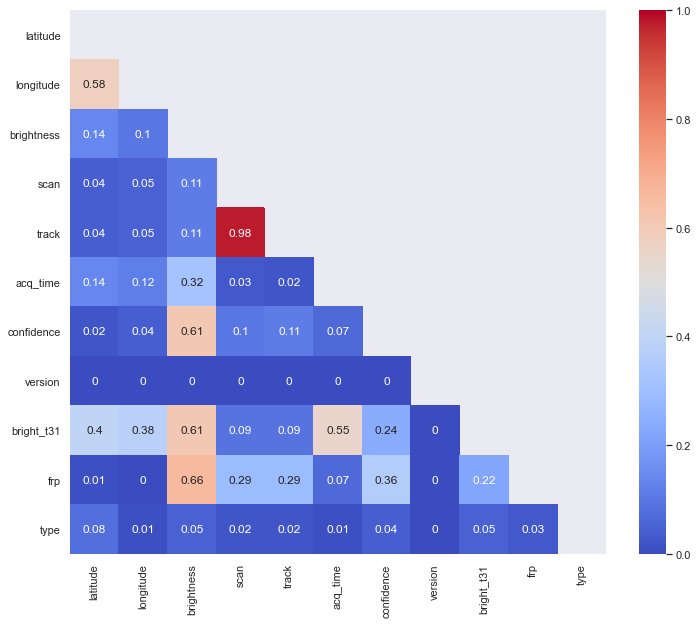

In [18]:
# Show the correlation matrix of the datas in df1
plt.figure(figsize= (12, 10))
sns.heatmap(round(df1.corr().abs(), 2),
           mask = np.triu(df1.corr()),
           vmin =0,
           vmax = 1,
           annot= True,
           cmap = 'coolwarm')
plt.show()

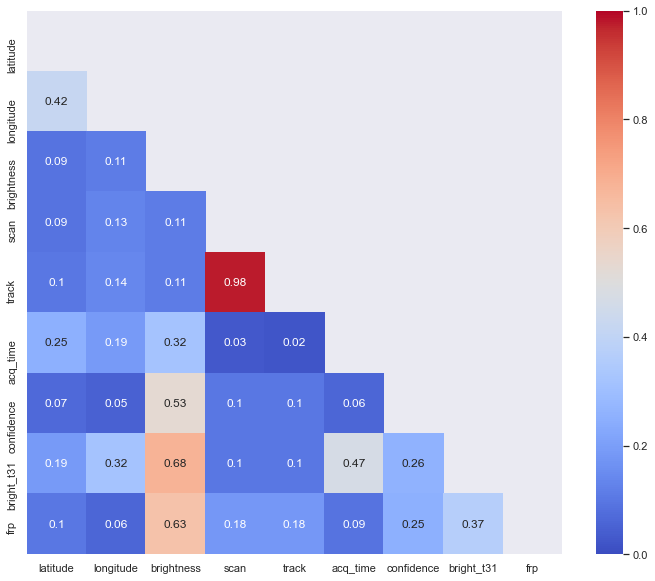

In [19]:
# Show the correlation matrix of the datas in df2
plt.figure(figsize= (12, 10))
sns.heatmap(round(df2.corr().abs(), 2),
           mask = np.triu(df2.corr()),
           vmin =0,
           vmax = 1,
           annot= True,
           cmap = 'coolwarm')
plt.show()

In [20]:
print('For df1, the column `satelitte` looks like \n', df1.satellite.value_counts(),
      '\n','For df2, the column `satelitte` looks like\n',  df2.satellite.value_counts())

For df1, the column `satelitte` looks like 
 Aqua     20541
Terra    15470
Name: satellite, dtype: int64 
 For df2, the column `satelitte` looks like
 Aqua     100010
Terra     83583
Name: satellite, dtype: int64


<AxesSubplot:xlabel='track', ylabel='Count'>

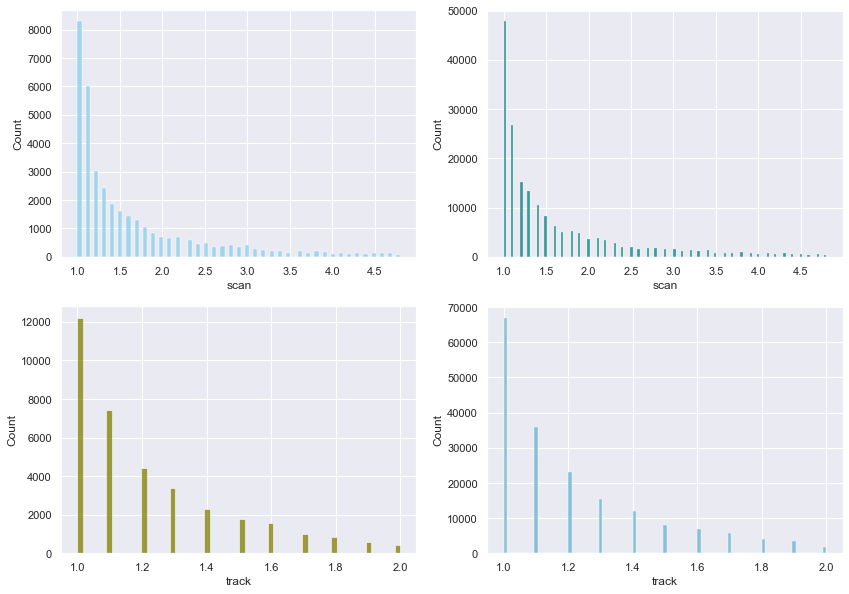

In [21]:
# Look at the distribution of the values for the scan and track to see which one is the best
f, axes = plt.subplots(2, 2, figsize=(14, 10))
sns.histplot(df1.scan, color="skyblue", ax=axes[0, 0])
sns.histplot(df2.scan, color="teal", ax=axes[0, 1])
sns.histplot(df1.track, color="olive", ax=axes[1, 0])
sns.histplot(df2.track, color="c", ax=axes[1,1])

**The dataset seems pretty good, some modification will be needed :**

1. The columns `instrument` and `version` are constant in each DataFrame. It won't be interesting for us.
2. The column `type` is useless, one value represent more than 99% of all the values. So it's almost a constant, it can be dropped. 
3. There is a very high correlation between `scan` and `track` columns : it's a sign of colinearity. The column `track` has less values,so it will be dropped.
4. Convert the object columns into integer or float for the analysis and the modelling. 
5. Check if we need to normalize / standardize the datas to avoid problem during the modelling.
6. Look at outliers that will cause problems during the modelling.
7. As the column type do not appears in `df2`, it is necessary to drop this column in `df1`.

In [22]:
# drop useless columns in df1
df1.drop(['instrument', 'version', 'track', 'type'], axis = 1, inplace = True)

In [23]:
# drop useless columns in df2
df2.drop(['instrument', 'version', 'track'], axis = 1, inplace = True)

In [24]:
# concatenate the 2 DataFrames
df = pd.concat([df1,df2], axis=0)

In [25]:
df.shape

(219604, 11)

In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 219604 entries, 0 to 183592
Data columns (total 11 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   latitude    219604 non-null  float64
 1   longitude   219604 non-null  float64
 2   brightness  219604 non-null  float64
 3   scan        219604 non-null  float64
 4   acq_date    219604 non-null  object 
 5   acq_time    219604 non-null  int64  
 6   satellite   219604 non-null  object 
 7   confidence  219604 non-null  int64  
 8   bright_t31  219604 non-null  float64
 9   frp         219604 non-null  float64
 10  daynight    219604 non-null  object 
dtypes: float64(6), int64(2), object(3)
memory usage: 20.1+ MB


In [27]:
# Create a column called month
df['month'] = pd.to_datetime(df['acq_date']).dt.to_period('M')

In [28]:
df.head()

,latitude,longitude,brightness,scan,acq_date,acq_time,satellite,confidence,bright_t31,frp,daynight,month
0,-11.8070,142.0583,313.0,1.0,2019-08-01,56,Terra,48,297.3,6.6,D,2019-08
1,-11.7924,142.0850,319.3,1.0,2019-08-01,56,Terra,71,297.3,11.3,D,2019-08
2,-12.8398,132.8744,311.6,3.1,2019-08-01,57,Terra,42,298.7,23.1,D,2019-08
3,-14.4306,143.3035,310.1,1.1,2019-08-01,57,Terra,33,296.1,6.5,D,2019-08
4,-12.4953,131.4897,310.3,4.0,2019-08-01,57,Terra,36,298.8,27.6,D,2019-08


In [29]:

df.groupby('month')['confidence'].mean().to_frame()

,confidence
month,
2019-08,65.568783
2019-09,69.182467
2019-10,73.235302
2019-11,73.561626
2019-12,75.610788
2020-01,77.537886


In [30]:
df_month = pd.pivot_table(df, index='month', columns = 'satellite', values = 'brightness', aggfunc='mean')
df_month

satellite,Aqua,Terra
month,,
2019-08,327.824545,322.574017
2019-09,334.554171,327.081965
2019-10,340.765919,332.652478
2019-11,340.967782,331.707845
2019-12,342.869850,334.777837
2020-01,353.685826,332.794171


In [31]:
#plotly libs
import plotly.graph_objs as go
import plotly.express as px
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [32]:
df['month'] = df.month.astype(str)

In [33]:
df.brightness.agg([min, max])

min    300.0
max    507.0
Name: brightness, dtype: float64

In [34]:
df.shape

(219604, 12)

In [35]:
df.head()

,latitude,longitude,brightness,scan,acq_date,acq_time,satellite,confidence,bright_t31,frp,daynight,month
0,-11.8070,142.0583,313.0,1.0,2019-08-01,56,Terra,48,297.3,6.6,D,2019-08
1,-11.7924,142.0850,319.3,1.0,2019-08-01,56,Terra,71,297.3,11.3,D,2019-08
2,-12.8398,132.8744,311.6,3.1,2019-08-01,57,Terra,42,298.7,23.1,D,2019-08
3,-14.4306,143.3035,310.1,1.1,2019-08-01,57,Terra,33,296.1,6.5,D,2019-08
4,-12.4953,131.4897,310.3,4.0,2019-08-01,57,Terra,36,298.8,27.6,D,2019-08


In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 219604 entries, 0 to 183592
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   latitude    219604 non-null  float64
 1   longitude   219604 non-null  float64
 2   brightness  219604 non-null  float64
 3   scan        219604 non-null  float64
 4   acq_date    219604 non-null  object 
 5   acq_time    219604 non-null  int64  
 6   satellite   219604 non-null  object 
 7   confidence  219604 non-null  int64  
 8   bright_t31  219604 non-null  float64
 9   frp         219604 non-null  float64
 10  daynight    219604 non-null  object 
 11  month       219604 non-null  object 
dtypes: float64(6), int64(2), object(4)
memory usage: 21.8+ MB


In [37]:
fig = px.density_mapbox(df, 
                        lat ='latitude', 
                        lon ='longitude', 
                        z = 'brightness', 
                        color_continuous_scale  = 'solar',
                        range_color = [300, 507],
                        radius = 5,
                        hover_name= 'brightness',
                        hover_data=['satellite'],
                        animation_frame= 'acq_date',
                        center = dict(lat=-27, lon=135), 
                        zoom = 3,
                        mapbox_style = 'carto-darkmatter',
                        height=700
                        )
fig.update_layout(title='Australian Fires from August 2019 to January 2020')
fig.show()

In [38]:
import plotly.io as pio

In [39]:
os.ch
pio.write_html(fig, file='map_fire.html')

In [40]:
data = df.month.value_counts()
data = [go.Bar(
            x=data.index,
            y=data.values,
            hoverinfo = 'text',
            marker = dict(color = 'darkorange',
                             line=dict(color='rgb(0,0,0)',width=1.5)),
    )]

layout = dict(
    title = 'Fire detected by month',
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [41]:
data = df.satellite.value_counts()
data = [go.Bar(
            x=data.index,
            y=data.values,
            hoverinfo = 'text',
            marker = dict(color = ['skyblue', 'mediumspringgreen'],
                             line=dict(color='rgb(0,0,0)',width=1.5))
    )]


layout = dict(
    title = 'Satellite detecting the fires',
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [42]:
df_month.reset_index(inplace = True)

In [43]:
df_month['month'] = df_month.month.astype(str)

In [44]:
fig = go.Figure()
fig.add_trace(go.Bar(x=df_month.month,
                y=df_month.Aqua,
                name='Aqua',
                marker = dict(color = 'skyblue',
                             line=dict(color='rgb(0,0,0)',width=1))
                ))
fig.add_trace(go.Bar(x=df_month.month,
                y=df_month.Terra,
                name='Terra',
                marker = dict(color = 'palegreen',
                             line=dict(color='rgb(0,0,0)',width=1))
                ))

fig.update_layout(
    title='Satellite detecting the fires per month',
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='Number of fire detected',
        titlefont_size=16,
        tickfont_size=14,
    ),
    legend=dict(
        x=1.0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.15, # gap between bars of adjacent location coordinates.
    bargroupgap=0.1 # gap between bars of the same location coordinate.
)
fig.show()